<h1> Optical Character Recognition </h1>

OCR  is a technology that converts scanned documents or images into editable and searchable text. It helps analyze documents by extracting text, enabling tasks such as search, data extraction, document classification, translation, sentiment analysis, and fraud detection. OCR automates document processing, improving efficiency, accessibility for visually impaired individuals, and providing insights from document content.

## Image Registration

Image registration is a process of aligning two or more images of the same scene taken at different times, from different viewpoints, or by different sensors. The goal is to geometrically align these images so that corresponding features in the scene match up. This alignment enables comparison, analysis, and integration of information from multiple images.

Image registration is an example of a Feature detection and Matching problem. So, all the stages in the feature detection and matching pipeline: feature detection, feature description, feature matching are involved in this problem.



In [1]:
# Importing required libraries
import cv2
import matplotlib.pyplot as plt
import json
import numpy as np

# Setting matplotlib configurations globally
plt.rcParams['xtick.labelsize'] = 0
plt.rcParams['ytick.labelsize'] = 0
plt.rcParams['xtick.bottom'] = False
plt.rcParams['ytick.left'] = False

In [44]:
ref_image_path = '../Images/reference.png'
query_image_path = '../Images/data_rotate.png'

# Load reference and query images
ref_image_bgr = cv2.imread(ref_image_path)
query_image_bgr = cv2.imread(query_image_path)

In [3]:
def show_img(image, title=None, ncols=2, figsize=(12, 15)):
    '''
    Visualize an image or a set of images using subplot

    Parameters
    ----------
    image : numpy.ndarray or list of numpy.ndarray
             Image array or the collection of image arrays to be displayed
    title : str ot list of str, optional, default: None
            The title or collection of titles corresponding to the images
    ncols: int, optional, default: 2
           Number of columns for subplot
    figsize: (float, float), optional, default: (12, 15)
             width, height in inches for single image

    Returns
    -------
    None
    '''

    if not isinstance(image, list):
        plt.figure(figsize=figsize)
        plt.imshow(image)
        if title:
            plt.title(title, fontsize=30)
    else:
        plt.figure(figsize=(50, 75))
        # calculate the number of rows
        nrows = int(np.ceil((len(image)) / ncols))
        for i, img in enumerate(image):
            plt.subplot(nrows, ncols, i+1)
            plt.imshow(img)
            if title:
                plt.title(title[i], fontsize=50)
    plt.show()

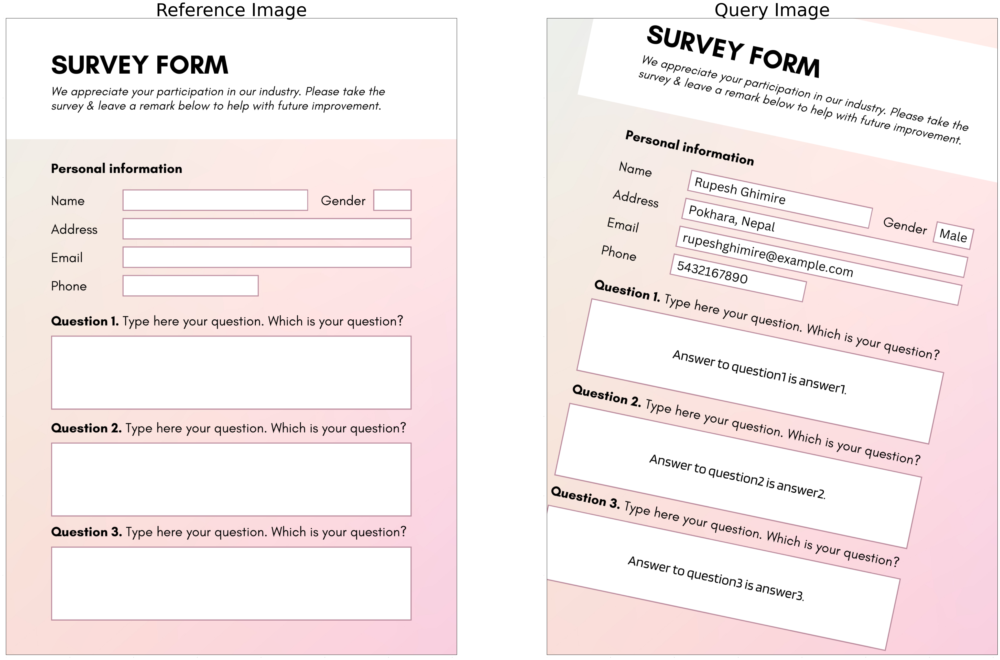

In [4]:
# Convert images from BGR to RGB
ref_image = cv2.cvtColor(ref_image_bgr, cv2.COLOR_BGR2RGB)
query_image = cv2.cvtColor(query_image_bgr, cv2.COLOR_BGR2RGB)

show_img([ref_image, query_image],
       ['Reference Image', 'Query Image'])

# Load, Extract, and Visualize the ROIs

Region of interest are portions of images where we need to perform some operations. In this project, ROIs are areas in the image from which the text needs to be extracted.

Constructed a json file that has informations about ROIs corresponding to the reference image. It has top-left coordinate of ROI followed by height and width of the rectangle making up ther ROI. It has names and other features.

```shape_attributes```: contain information about the rectangle boundary

```region_attributes```: contain information about the image and roi label

In [5]:
from pprint import pprint
import json as json


file_path='../roi_config.json'


try:
    with open(file_path, "r") as f:
        content = f.read()
        if content.strip() == "":
            print("Error: File is empty.")
        else:
            config = json.loads(content)["config"]
            rois = config["rois"]
            pprint(rois)
except FileNotFoundError:
    print("Error: File not found.")
except json.JSONDecodeError as e:
    print("Error decoding JSON:", e)

[{'region_attributes': {'image_quality': {'frontal': True,
                                          'good': True,
                                          'good_illumination': True},
                        'name': 'name',
                        'type': 'unknown'},
  'shape_attributes': {'height': 65,
                       'name': 'rect',
                       'width': 582,
                       'x': 364,
                       'y': 543}},
 {'region_attributes': {'image_quality': {'frontal': True,
                                          'good': True,
                                          'good_illumination': True},
                        'name': 'gender',
                        'type': 'unknown'},
  'shape_attributes': {'height': 65,
                       'name': 'rect',
                       'width': 116,
                       'x': 1155,
                       'y': 537}},
 {'region_attributes': {'image_quality': {'frontal': True,
                                      

In [6]:
def get_fields(image, rois, save_rois=False):
    '''
    Takes image, using roi_config.json file generated dict of rois, saves them in field according to their:
    name, boundary(top left and bottom right coordinates) and roi_image which is portion of image within those coordinates.
    Returns fields which is list of dictionaries of ROI data
    '''

    print("Cropping image rois.\n")
    fields = []
    for roi in rois:
        k, v = roi['region_attributes']['name'], roi['shape_attributes']

        x1 = int(v['x'])
        x2 = int(x1) + int(v['width'])
        y1 = int(v['y'])
        y2 = int(y1) + int(v['height'])

        roi_image = image[y1:y2, x1:x2]

        if save_rois:
            cv2.imwrite(f"rois/{k}.jpg", roi_image)

        fields.append({'roi_label': k,
                       'roi_boundary': [(x1, y1), (x2, y2)] ,
                       'roi_image': roi_image})

        print("ROI: {} added".format(k))

    print("\nDone Cropping image rois.\n")
    if save_rois:
        print("Cropped ROI Images saved at path: rois/")
    return fields

In [7]:
def visualize_rois(image):
    """
    Takes image, makes it's copy, gets ROI fields as described in json file, adds ROIs as rectangle and plots the image
    Returns the ROI boxed/annotated image
    """

    # Avoid in place changes to the image
    image = image.copy()

    # Create the ROIs information
    roi_fields = get_fields(image, rois)

    # Define attributes for rectangle
    color = (0, 0, 255)  # rgb -> blue
    thickness = 3

    # Draw all roi bounding boxes
    for roi_field in roi_fields:

        a,b = roi_field["roi_boundary"]
        image = cv2.rectangle(image,a,b,color,thickness)


    show_img(image, "Reference image with ROIs")

    return image

Cropping image rois.

ROI: name added
ROI: gender added
ROI: address added
ROI: email added
ROI: phone added
ROI: question1 added
ROI: question2 added
ROI: question3 added

Done Cropping image rois.



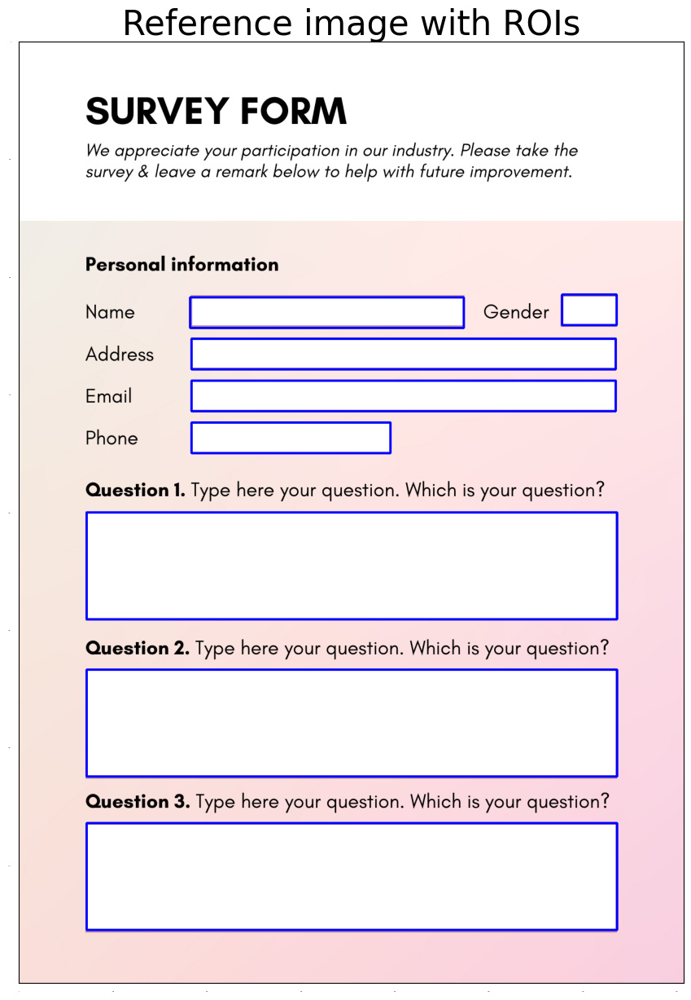

In [8]:
ref_roi_image = visualize_rois(ref_image)


## Fearure Detection and Descriptor - SIFT

SIFT, or Scale-Invariant Feature Transform, is a computer vision technique for detecting and describing distinctive features in images. It identifies keypoints at locations with significant changes in gradient magnitude and direction across different scales of the image. Once keypoints are detected, SIFT creates descriptors that encode information about the local appearance of each keypoint, making them invariant to changes in scale, rotation, and illumination. These descriptors enable tasks such as image matching, object recognition, and image stitching in applications ranging from robotics and augmented reality to medical imaging and security.

In [10]:
def get_features(images_dict):
    '''
    Get keypoints and descriptors from images

    Parameters
    ----------
    images_dict: dict
                 dictionary containing image_name: image.
                 The image is of type numpy.ndarray
    Performs
    --------
    Initialize SIFT descriptor. Convert image to grayscale and extract keypoints and make feature dict.

    Returns
    -------
    features: dict
              a dictionary of feature dictionary containing
              'keypoints', 'descriptors' and 'image' for each
              'image_name'
              The image is a gray scale version of the input image
    '''

    features = {}
    print("Extracting keypoints and descriptors")

    sift = cv2.SIFT_create()
    for label, image in images_dict.items():
        image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        keypoints, descriptors = sift.detectAndCompute(image, None)
        features[label] = {'keypoints': keypoints, 'descriptors': descriptors, 'image': image}

    print("Keypoints and descriptors extracted")
    return features

In [16]:
images_dict = {'query': query_image, 'reference': ref_image}
features = get_features(images_dict)

Extracting keypoints and descriptors
Keypoints and descriptors extracted


#### Visualize keypoints

In [17]:
def visualize_keypoints(features):
    """
    Display detected keypoints in image

    Parameters
    ----------
    features: dict
              a dictionary of feature dictionary containing
              'keypoints', 'descriptors' and 'image' for each
              'image_name'
              The image is a gray scale version of the input image

    Returns
    -------
    None
    """

    kp_images = []

    keypoints_flag = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS
    for image_name in features.keys():
        kp_image = cv2.drawKeypoints(features[image_name]['image'],
                                      features[image_name]['keypoints'],
                                      -1,
                                      flags=keypoints_flag)
        kp_images.append(kp_image)

    show_img(kp_images, ['Query Image Keypoints',
                       'Reference Image Keypoints'])

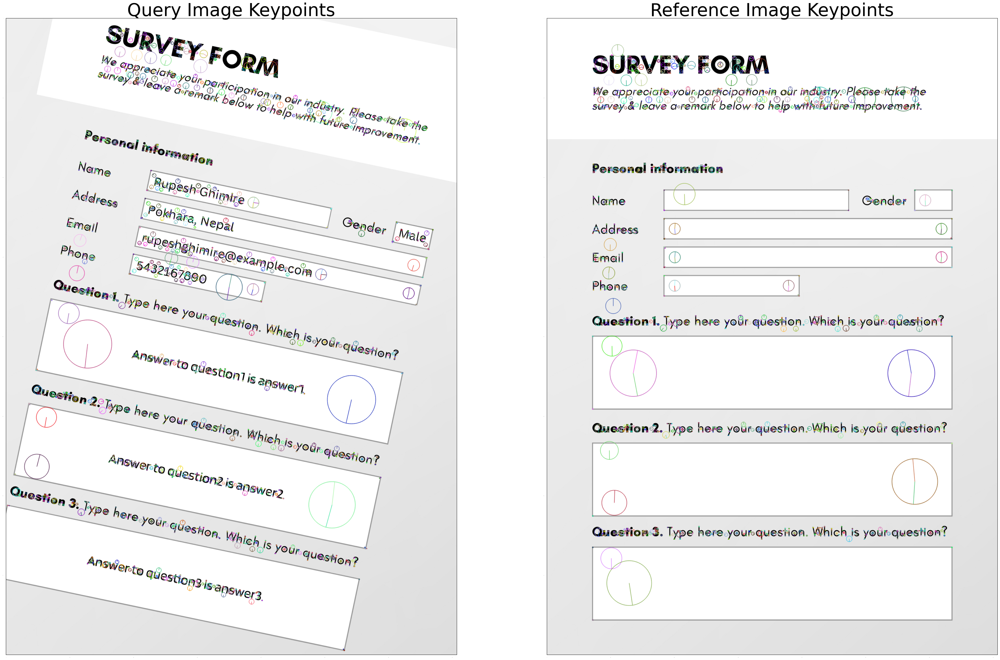

In [18]:
visualize_keypoints(features)

### Feature Matching

- match the features obtained with bruteforce
- threshold to find good match
- Vizualize

In [19]:
# thresholidng to get good match from bruteforce matches
def get_good_matches(matches, ratio_threshold):
    print("Filtering good matches")
    good_matches = []
    for match in matches:
        if match[1].distance != 0:
            dist_ratio = match[0].distance / match[1].distance
            if dist_ratio < ratio_threshold:
              good_matches.append(match[0])
    print("Good matches filtered")
    return good_matches



def get_descriptor_matches(descriptors1, descriptors2):
    # knnMatch parameter: number of matches for each descriptor
    k = 2

    matches12 = None
    matches21 = None

    # Bruteforce matcher
    bf = cv2.BFMatcher()

    matches_12 = bf.knnMatch(descriptors1,descriptors2, k=k)
    matches_21 = bf.knnMatch(descriptors2,descriptors1, k=k)

    print("Raw matches extracted")

    # Filter the good matches
    good_matches_12 = get_good_matches(matches_12, ratio_threshold=0.75)
    good_matches_21 = get_good_matches(matches_21, ratio_threshold=0.75)

    # Use the common matches
    good_matches_21_dict = {(m.trainIdx, m.queryIdx) for m in good_matches_21}
    matches = [m for m in good_matches_12
               if (m.queryIdx, m.trainIdx) in good_matches_21_dict]

    print("Processed descriptor matches extracted")
    return matches

In [20]:
descriptors1 = features['query']['descriptors']
descriptors2 = features['reference']['descriptors']
matches = get_descriptor_matches(descriptors1, descriptors2)
print("Number of matches obtained = {}".format(len(matches)))

Raw matches extracted
Filtering good matches
Good matches filtered
Filtering good matches
Good matches filtered
Processed descriptor matches extracted
Number of matches obtained = 684


In [21]:
def visualize_matches(features, matches):
    matches_image = cv2.drawMatchesKnn(features['query']['image'],
                                       features['query']['keypoints'],
                                       features['reference']['image'],
                                       features['reference']['keypoints'],
                                       [matches], None,
                                       flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    show_img(matches_image,
           "Matches between query and reference images",
           figsize=(40, 40))

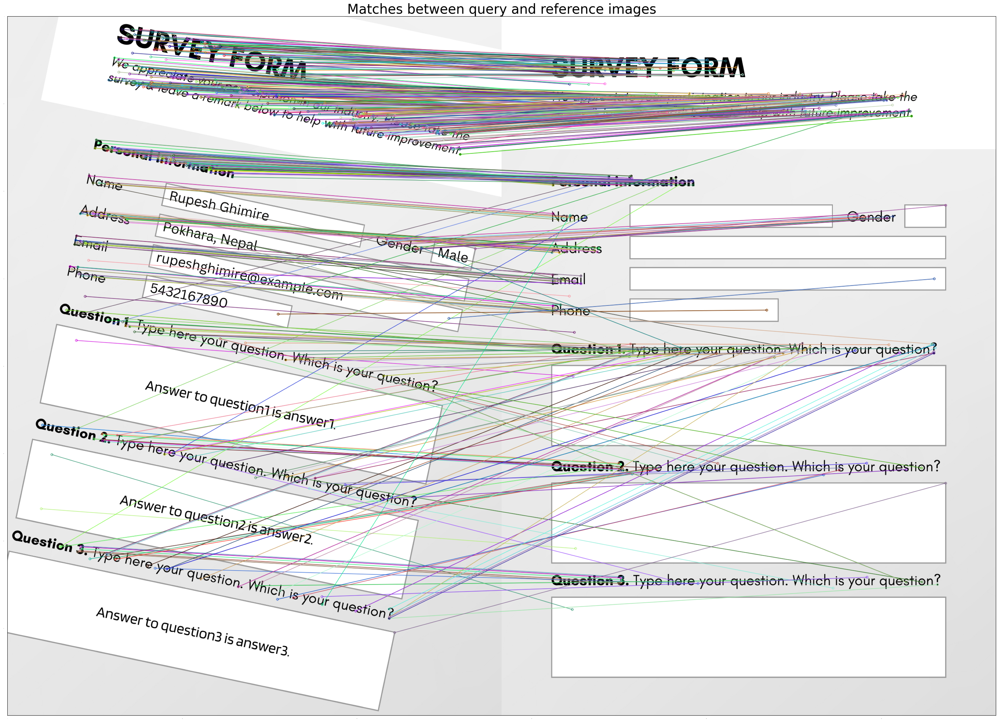

In [22]:
visualize_matches(features, matches)


## Image Warping


After finding matching features between a query image and a reference image, we need to align them. This process, called image warping, involves transforming the pixels of the query image to match those of the reference image. In computer vision, we use a homography to represent this transformation. A homography is a 3x3 matrix that describes how points in one image correspond to points in another. We use algorithms like RANSAC to compute this homography, which helps remove outliers in the matches. Once we have the homography matrix, we apply it to the query image using OpenCV's ```cv2.warpPerspective() ```function, which warps the image based on the matrix and the reference image's dimensions. This aligns the query image with the reference image, allowing for accurate comparison and analysis.

In [23]:
def warp_image(features, matches, images_dict):

    print("Warping query image")
    # Initialize the source and target points
    src_points = np.zeros((len(matches), 2), dtype=np.float32)
    target_points = np.zeros((len(matches), 2), dtype=np.float32)

    # Extract location of good matches and
    # fill the source and target points
    for i, match in enumerate(matches):
        src_points[i, :] = features['query']['keypoints'][match.queryIdx].pt
        target_points[i, :] = features['reference']['keypoints'][match.trainIdx].pt

    h = None
    warped_image = None

    print("Extracting homography matrix")
    # homography matrix
    h, mask = cv2.findHomography(src_points, target_points, cv2.RANSAC, 5)
    # warping query image
    height, width = features['reference']['image'].shape
    registered_image = cv2.warpPerspective(images_dict['query'], h,(width, height))
    print("Homography matrix extracted:")
    print(h)

    print("Query image warped")
    return registered_image, h

In [24]:
registered_image, h = warp_image(features, matches, images_dict)

Warping query image
Extracting homography matrix
Homography matrix extracted:
[[ 9.78504657e-01  2.05995189e-01 -1.76337576e+02]
 [-2.05752798e-01  9.79211581e-01  1.65298411e+02]
 [-2.51210534e-07  5.68290898e-07  1.00000000e+00]]
Query image warped


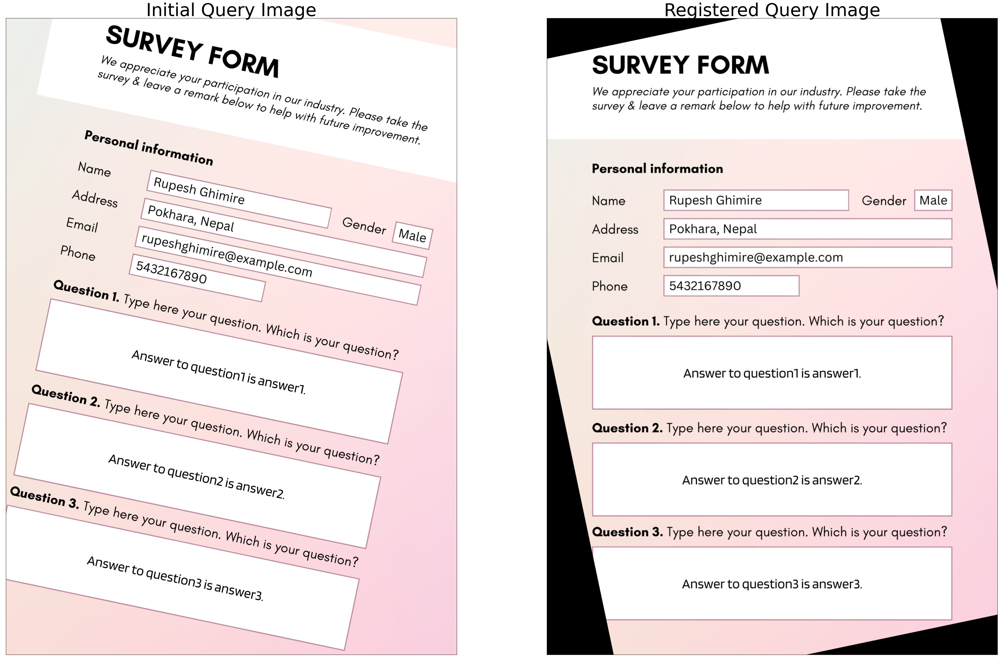

In [25]:
show_img([images_dict['query'], registered_image],
       ["Initial Query Image", "Registered Query Image"])

## Register Image

In [26]:
def registerImage(images_dict):
    print("Applying image registration.")

    # 1. Feature detection and description
    features = get_features(images_dict)
    visualize_keypoints(features)

    # 2. Feature matching
    matches = get_descriptor_matches(features['query']['descriptors'],
                                     features['reference']['descriptors'])
    num_matches = len(matches)
    print('Number of Matches:', num_matches)
    visualize_matches(features, matches)

    # 3. Image warping using homography
    registered_image, h = warp_image(features, matches, images_dict)
    show_img([images_dict['query'], registered_image],
       ["Initial Query Image", "Registered Query Image"])
    print("Image Registration completed")
    return registered_image

Applying image registration.
Extracting keypoints and descriptors
Keypoints and descriptors extracted


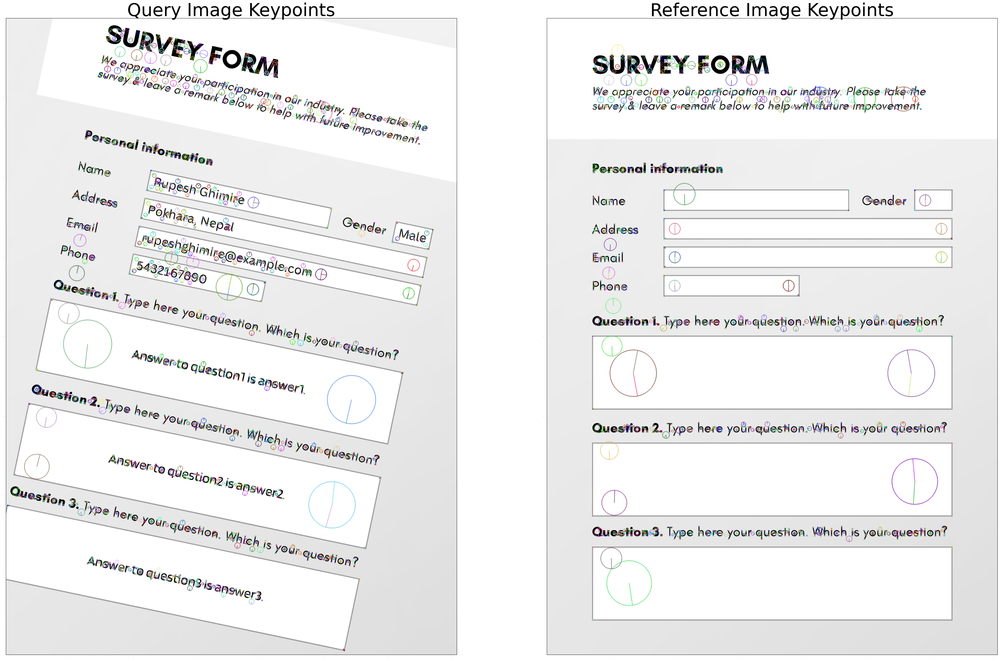

Raw matches extracted
Filtering good matches
Good matches filtered
Filtering good matches
Good matches filtered
Processed descriptor matches extracted
Number of Matches: 684


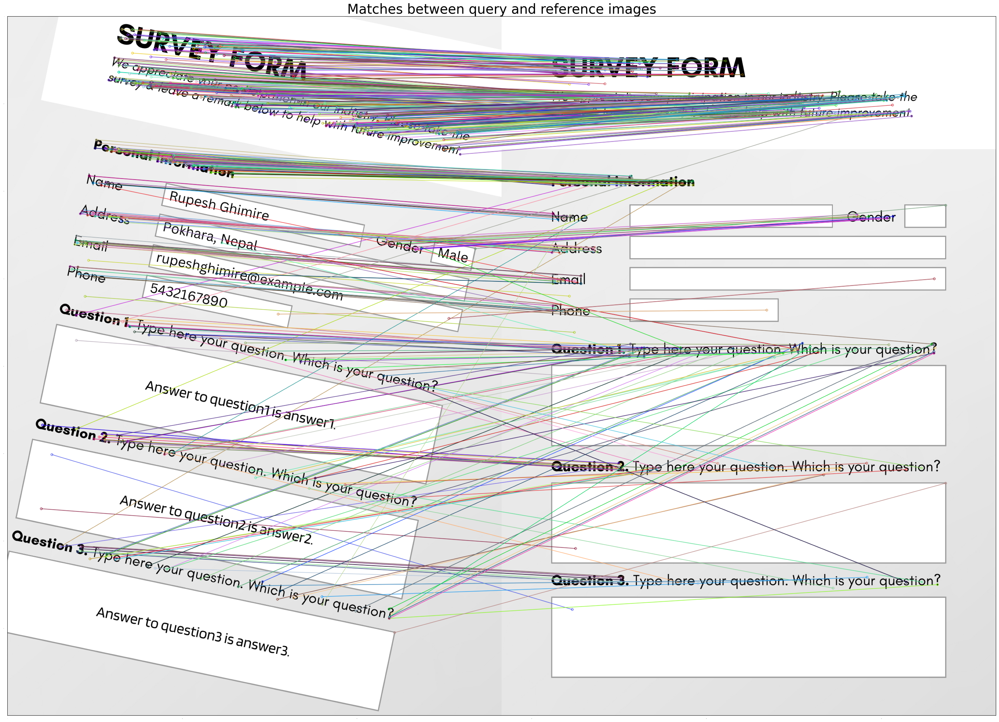

Warping query image
Extracting homography matrix
Homography matrix extracted:
[[ 9.78504657e-01  2.05995189e-01 -1.76337576e+02]
 [-2.05752798e-01  9.79211581e-01  1.65298411e+02]
 [-2.51210534e-07  5.68290898e-07  1.00000000e+00]]
Query image warped


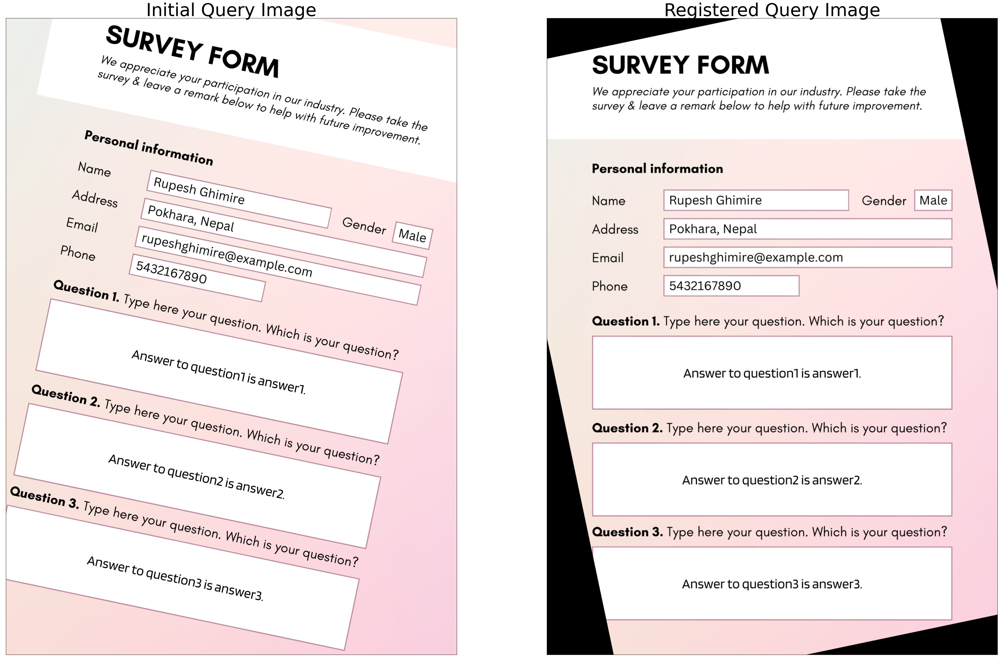

Image Registration completed


In [27]:
images_dict = {'query': query_image, 'reference': ref_image}
registered_image = registerImage(images_dict)

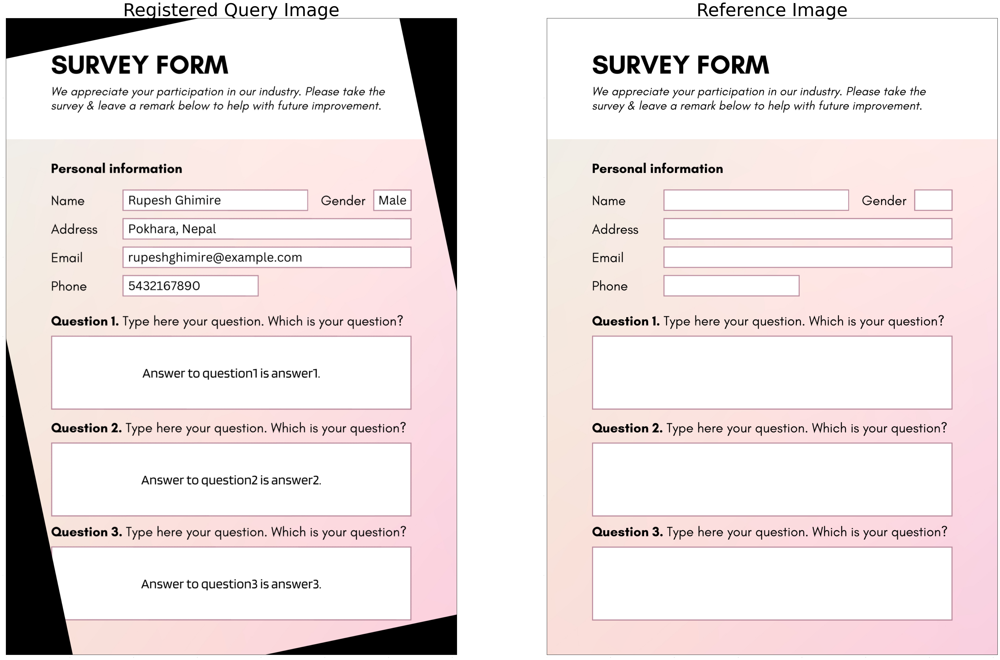

In [28]:
show_img([registered_image, images_dict['reference']],
      ["Registered Query Image", "Reference Image"])

## MSE

The Mean Squared Error (MSE) between the two images is the sum of the squared difference between the pixel values of two images. The two images must have the same dimensions for computing the MSE.

In [34]:
def mse(image1, image2):
    show_img([image1, image2])
    err = np.mean(np.square(image1 - image2))

    return err

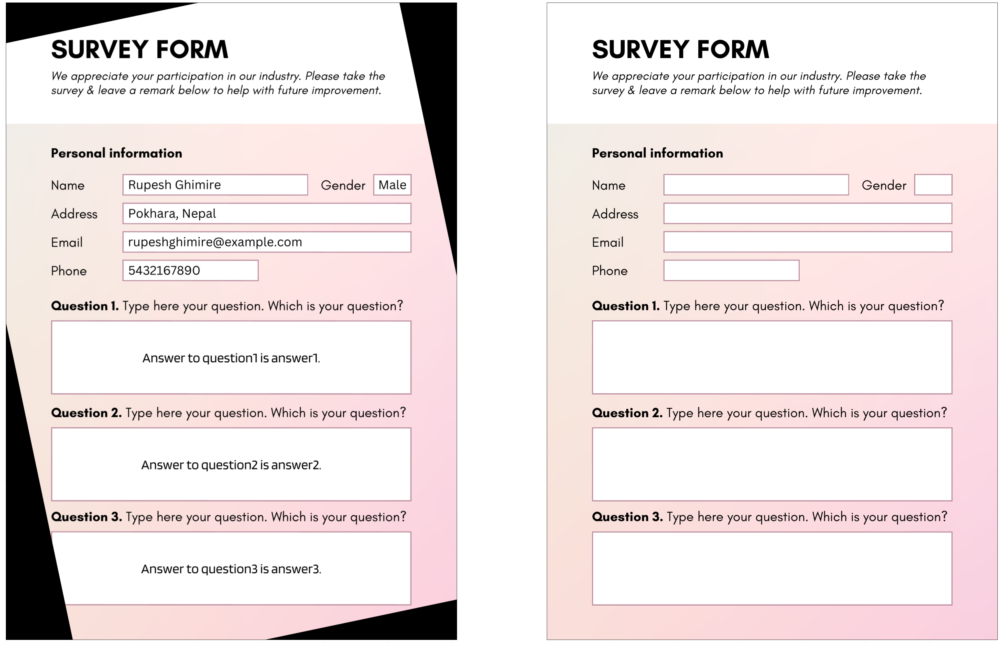

Mean Squared error = 10.908977958510137


In [35]:
error = mse(registered_image, ref_image)
print("Mean Squared error = {}".format(error))

Cropping image rois.

ROI: name added
ROI: gender added
ROI: address added
ROI: email added
ROI: phone added
ROI: question1 added
ROI: question2 added
ROI: question3 added

Done Cropping image rois.



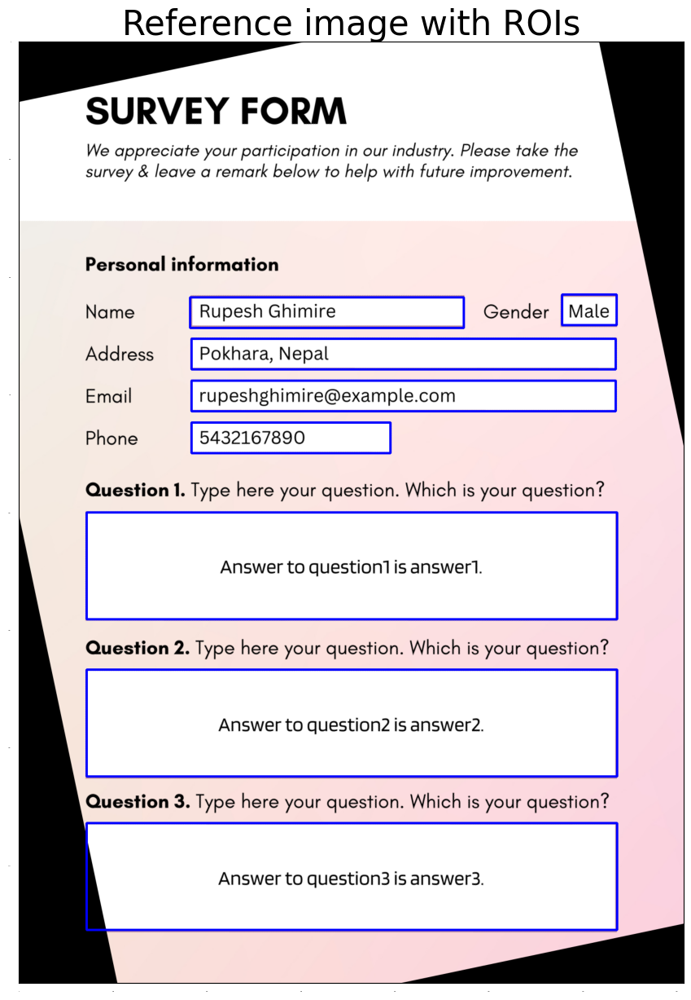

In [36]:
registered_image_rois = visualize_rois(registered_image)

It looks good. Image registration helped to make query image similar to reference image. We will now perform prediction of text in the ROIs.

## Text Prediction

In [37]:
!pip install pytesseract
!sudo apt install tesseract-ocr
!sudo apt install libtesseract-dev

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 32 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 1s (9,577 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debc

In [38]:
import pytesseract
import pandas as pd

def predict(image):
    output = {}
    roi_fields = get_fields(image, rois)
    for roi_dict in roi_fields:
        roi_image = roi_dict['roi_image']
        roi_type = roi_dict['roi_label']
        predicted_text = pytesseract.image_to_string(roi_image)
        output[roi_type] = [predicted_text.rstrip()]
    df_output = pd.DataFrame.from_dict(output, orient='index')
    df_output.columns = ['predicted text']
    return df_output

predictions = predict(registered_image)
predictions

Cropping image rois.

ROI: name added
ROI: gender added
ROI: address added
ROI: email added
ROI: phone added
ROI: question1 added
ROI: question2 added
ROI: question3 added

Done Cropping image rois.



,predicted text
name,Rupesh Ghimire
gender,Male
address,"\n\nPokhara, Nepal"
email,\n\n \n\nrupeshghimire@example.com
phone,\n\n5432167890
question1,\n\nAnswer to question] is answer.
question2,\n\nAnswer to question2 is answer2.
question3,\n\nAnswer to question3 is answer3.


In [43]:
# Looks good but there are escape characters for new line let's remove those
predictions['predicted text'] = predictions['predicted text'].apply(lambda x: x.replace("\n", ""))
predictions

,predicted text
name,Rupesh Ghimire
gender,Male
address,"Pokhara, Nepal"
email,rupeshghimire@example.com
phone,5432167890
question1,Answer to question] is answer.
question2,Answer to question2 is answer2.
question3,Answer to question3 is answer3.
